# Jet Energy Resolution Computations

In [1]:
import awkward as ak
import numpy as np
import coffea
import uproot
import hist
import vector
from coffea import util, processor
from coffea.nanoevents import NanoEventsFactory, NanoAODSchema, BaseSchema
from distributed.diagnostics.plugin import UploadDirectory
import matplotlib.pyplot as plt
from collections import defaultdict
import os
import pickle
import correctionlib
from coffea.analysis_tools import PackedSelection
from dask.distributed import Client
from scipy.optimize import curve_fit
import csv
np.seterr(divide='ignore', invalid='ignore')
from python.smp_utils import *

In [2]:
with open("pkl_files/QCD_pt_response_04-29.pkl", "rb") as f:
    output = pickle.load(f)
    
for k,v in output.items():
    print(k)

responses_histogram_rho
corrections_histogram
cutflow


In [3]:
output['cutflow'].keys() 

dict_keys(['2018', '2017', '2016APV', '2016'])

### Loading and Plotting PKL File Output

Let's start by plotting the histograms that contain data for the ratio of reconstructed jet $p_{T}$ to generated jet $p_{T}$; we use the `output["responses_histogram"]` key and project it to `dataset` and the variable of interest, such as `.project("dataset", "pt")`, `.project("dataset", "frac")`, or `.project("dataset", "eta")`, for example.

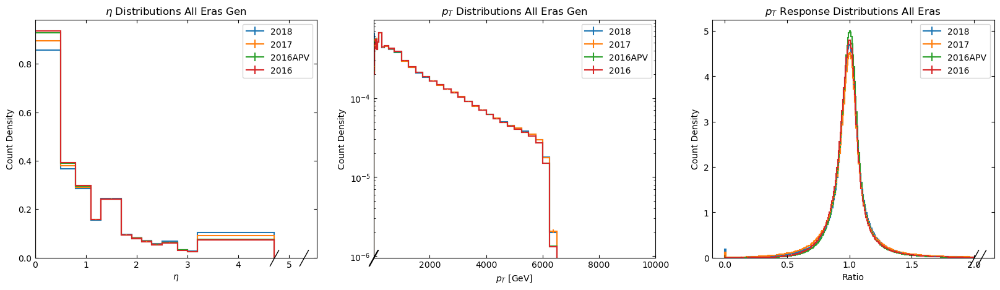

In [4]:
fig, axs = plt.subplots(1, 3, figsize=(20, 5))

output["responses_histogram_rho"].project('dataset', 'eta').plot(ax=axs[0], density=True)
output["responses_histogram_rho"].project('dataset', 'pt').plot(ax=axs[1], density=True)
output["responses_histogram_rho"].project('dataset', 'frac').plot(ax=axs[2], density=True)

axs[0].set_title("$\eta$ Distributions All Eras Gen") 
axs[0].set_ylabel("Count Density")
axs[0].set_xlim(0)
axs[0].legend(frameon=True)

axs[1].set_title("$p_T$ Distributions All Eras Gen") 
axs[1].set_ylabel("Count Density")
axs[1].set_yscale('log')
axs[1].set_xlim(10, 10000)
axs[1].legend(frameon=True)

axs[2].set_title("$p_T$ Response Distributions All Eras")    
axs[2].set_ylabel("Count Density")
axs[2].legend(frameon=True)

for ax in axs:
    ax.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
plt.show()

In [5]:
print(f".project('dataset', 'frac') numpy shape    ==>    {output['responses_histogram_rho'].project('dataset', 'frac').to_numpy()[0].shape}")
print(f".project('dataset', 'eta') numpy shape    ==>    {output['responses_histogram_rho'].project('dataset', 'eta').to_numpy()[0].shape}")
print(f".project('dataset', 'pt') numpy shape    ==>    {output['responses_histogram_rho'].project('dataset', 'pt').to_numpy()[0].shape}")
print(f".project('dataset', 'rho') numpy shape    ==>    {output['responses_histogram_rho'].project('dataset', 'rho').to_numpy()[0].shape}")

.project('dataset', 'frac') numpy shape    ==>    (4, 300)
.project('dataset', 'eta') numpy shape    ==>    (4, 13)
.project('dataset', 'pt') numpy shape    ==>    (4, 41)
.project('dataset', 'rho') numpy shape    ==>    (4, 7)


Next, we project the `output["corrections_histogram"]` histogram to its corresponding axes as well:

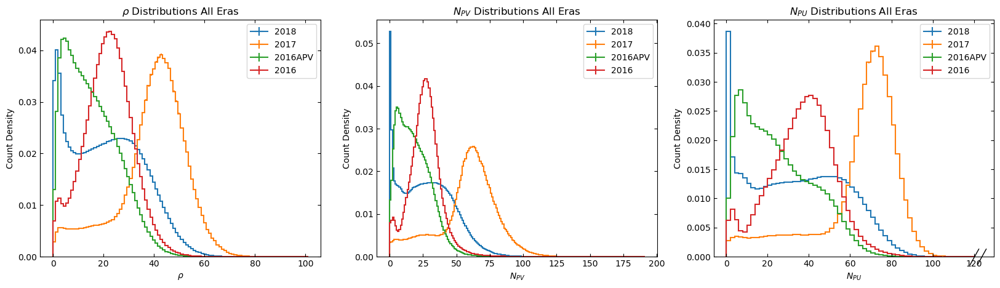

In [6]:
fig, axs = plt.subplots(1, 3, figsize=(20, 5))

output["corrections_histogram"].project('dataset', 'rho_fine').plot(ax=axs[0], density=True)
output["corrections_histogram"].project('dataset', 'npvs').plot(ax=axs[1], density=True)
output["corrections_histogram"].project('dataset', 'npu_fine').plot(ax=axs[2], density=True)

axs[0].set_title(r"$\rho$ Distributions All Eras")
axs[0].set_ylabel('Count Density')
axs[0].legend(frameon=True)

axs[1].set_title("$N_{PV}$ Distributions All Eras")
axs[1].set_ylabel('Count Density')
axs[1].legend(frameon=True)

axs[2].set_title("$N_{PU}$ Distributions All Eras")
axs[2].set_ylabel('Count Density')
axs[2].legend(frameon=True)

for ax in axs:
    ax.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
plt.show()

In [7]:
print(f".project('dataset', 'rho') numpy shape    ==>    {output['corrections_histogram'].project('dataset', 'rho_fine').to_numpy()[0].shape}")
print(f".project('dataset', 'npvs') numpy shape    ==>    {output['corrections_histogram'].project('dataset', 'npvs').to_numpy()[0].shape}")
print(f".project('dataset', 'npu') numpy shape    ==>    {output['corrections_histogram'].project('dataset', 'npu_fine').to_numpy()[0].shape}")

.project('dataset', 'rho') numpy shape    ==>    (4, 100)
.project('dataset', 'npvs') numpy shape    ==>    (4, 190)
.project('dataset', 'npu') numpy shape    ==>    (4, 60)


### Fitting Histograms and Plotting Curves for a Given Transverse Momentum Range

In order to add a fit to our historgrams, we start by defining the edges, centers, and widths of the bins for our quantities of interest, which will be the `dataset`, `frac`,`eta`, and `pt`; we use the `histogram_bin_extractor()` function defined in `smp_utils.py` to extract the bin edges, centers, and widths.

In [8]:
histograms = output["responses_histogram_rho"]

for axis in histograms.axes:
    print(f"Axis type: {axis}\n")

Axis type: StrCategory(['2018', '2017', '2016APV', '2016'], growth=True, name='dataset', label='Primary dataset')

Axis type: Regular(300, 0, 2, name='frac', label='Ratio')

Axis type: Variable([0, 0.5, 0.8, 1.1, 1.3, 1.7, 1.9, 2.1, 2.3, 2.5, 2.8, 3, 3.2, 4.7], name='eta', label='$\\eta$')

Axis type: Variable(array([   10.,    20.,    30.,    35.,    40.,    45.,    57.,    72.,
          90.,   120.,   150.,   200.,   300.,   400.,   550.,   750.,
        1000.,  1250.,  1500.,  1750.,  2000.,  2250.,  2500.,  2750.,
        3000.,  3250.,  3500.,  3750.,  4000.,  4250.,  4500.,  4750.,
        5000.,  5250.,  5500.,  5750.,  6000.,  6250.,  6500.,  6750.,
        7000., 10000.]), name='pt', label='$p_{T}$ [GeV]')

Axis type: Variable([0, 7.32, 13.2, 19.08, 24.95, 30.83, 36.71, 90], name='rho', label='$\\rho$')



In [9]:
histogram_bins = histogram_bin_extractor(output["responses_histogram_rho"])

eras = histogram_bins[0]
dataset_bin_edges, frac_bin_edges, eta_bin_edges, pt_bin_edges, rho_bin_edges = histogram_bins[1]
dataset_bin_centers, frac_bin_centers, eta_bin_centers, pt_bin_centers, rho_bin_centers = histogram_bins[2]
dataset_bin_widths, frac_bin_widths, eta_bin_widths, pt_bin_widths, rho_bin_widths = histogram_bins[3]

print(f"pt_bin_edges: {pt_bin_edges}\n\npt_bin_centers: {pt_bin_centers}\n\npt_bin_widths: {pt_bin_widths}\n")

pt_bin_edges: [   10.    20.    30.    35.    40.    45.    57.    72.    90.   120.
   150.   200.   300.   400.   550.   750.  1000.  1250.  1500.  1750.
  2000.  2250.  2500.  2750.  3000.  3250.  3500.  3750.  4000.  4250.
  4500.  4750.  5000.  5250.  5500.  5750.  6000.  6250.  6500.  6750.
  7000. 10000.]

pt_bin_centers: [  15.    25.    32.5   37.5   42.5   51.    64.5   81.   105.   135.
  175.   250.   350.   475.   650.   875.  1125.  1375.  1625.  1875.
 2125.  2375.  2625.  2875.  3125.  3375.  3625.  3875.  4125.  4375.
 4625.  4875.  5125.  5375.  5625.  5875.  6125.  6375.  6625.  6875.
 8500. ]

pt_bin_widths: [  10.   10.    5.    5.    5.   12.   15.   18.   30.   30.   50.  100.
  100.  150.  200.  250.  250.  250.  250.  250.  250.  250.  250.  250.
  250.  250.  250.  250.  250.  250.  250.  250.  250.  250.  250.  250.
  250.  250.  250.  250. 3000.]



We can then show the gen $\eta$ distributions of our eras in numpy:

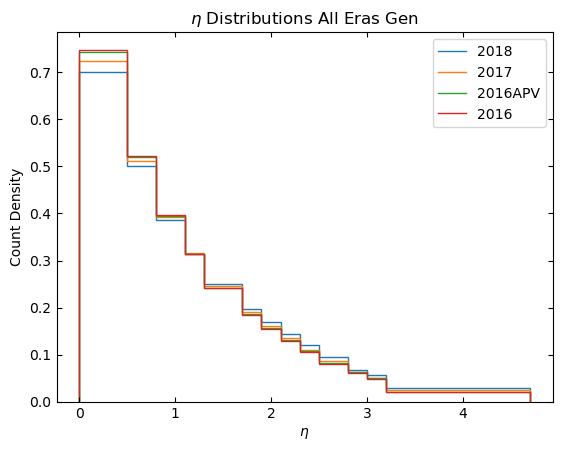

.project('dataset', 'eta') numpy shape    ==>    (4, 13)



In [10]:
np_histogram_dataset_eta, bin_edges = histograms.project("dataset", "eta").to_numpy()[0], eta_bin_edges
bin_widths = eta_bin_widths

for i in range(len(eras)):
    normalized_y_vals = np_histogram_dataset_eta[i] / (np.sum(np_histogram_dataset_eta[i]) * bin_widths)
    plt.stairs(normalized_y_vals, bin_edges, label=eras[i])
plt.title("$\eta$ Distributions All Eras Gen")
plt.xlabel(r"$\eta$")
plt.ylabel("Count Density")
plt.legend(frameon=True)
plt.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
plt.show()

print(f".project('dataset', 'eta') numpy shape    ==>    {histograms.project('dataset', 'eta').to_numpy()[0].shape}\n")

And then show the gen $p_T$ distributions as well:

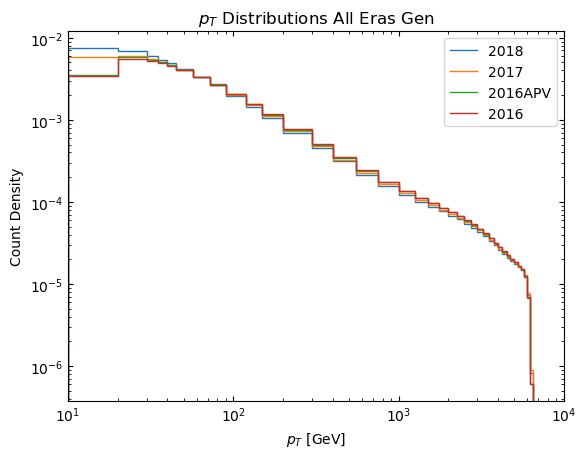

.project('dataset', 'pt') numpy shape    ==>    (4, 41)



In [11]:
np_histogram_dataset_pt, bin_edges = histograms.project("dataset", "pt").to_numpy()[0], pt_bin_edges
bin_widths = pt_bin_widths

for i in range(len(eras)):
    normalized_y_vals = np_histogram_dataset_pt[i] / (np.sum(np_histogram_dataset_pt[i]) * bin_widths)
    plt.stairs(normalized_y_vals, bin_edges, label=eras[i])
plt.title("$p_T$ Distributions All Eras Gen")
plt.xlabel(r"$p_T$ [GeV]")
plt.ylabel("Count Density")
plt.xscale("log")
plt.yscale("log")
plt.xlim(10, 10000)
plt.legend(frameon=True)
plt.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
plt.show()

print(f".project('dataset', 'pt') numpy shape    ==>    {histograms.project('dataset', 'pt').to_numpy()[0].shape}\n")

Having defined our bin dimensions, we now fit our histograms to gaussian functions (defined in `smp_utils.py`), and print their relevant parameters, such as their amplitudes, means, and widths. It is important to note that we are projecting the $p_{T}$ fraction ratio over the entire dataset through `.project('dataset', 'frac')`, and so the distributions obtained contain the response over their whole respective eras.

Era: 2018    |    amplitude: 0.028209863116612548    |    mean: 0.9985753404618692    |    stdev: 0.07872361327252239    |    .project('dataset', 'frac'): (4, 300)

Era: 2017    |    amplitude: 0.02696892739912998    |    mean: 0.9963632257298799    |    stdev: 0.08082922867797046    |    .project('dataset', 'frac'): (4, 300)

Era: 2016APV    |    amplitude: 0.030565363880899026    |    mean: 0.9986539437916367    |    stdev: 0.07549263724539935    |    .project('dataset', 'frac'): (4, 300)

Era: 2016    |    amplitude: 0.02917094493678959    |    mean: 0.9934896188967103    |    stdev: 0.07842752836112676    |    .project('dataset', 'frac'): (4, 300)



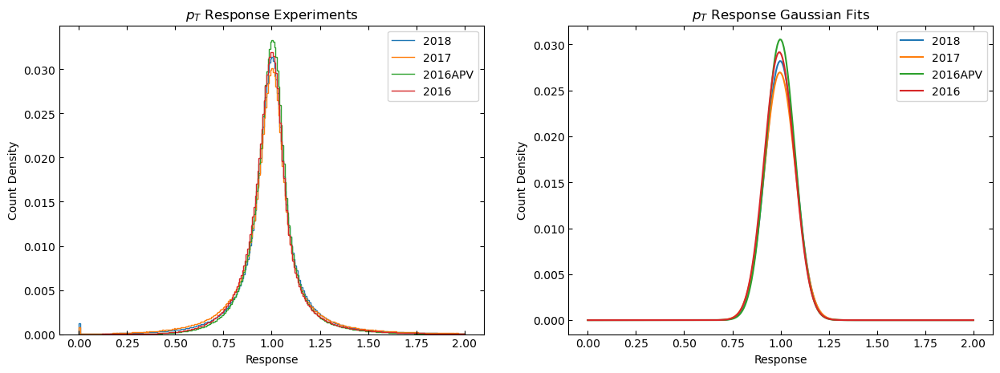

In [12]:
np_histogram_dataset_frac, bin_edges = histograms.project('dataset', 'frac').to_numpy()[0], frac_bin_edges
bin_centers = frac_bin_centers
frac_xspace = np.linspace(0, 2, 300)

fig, axs = plt.subplots(1, 2, figsize=(15, 5))

for i in range(len(eras)):
    normalized_y_vals = np_histogram_dataset_frac[i] / np.sum(np_histogram_dataset_frac[i])
    popt, pcov = curve_fit(gaussian_function, xdata=bin_centers, ydata=normalized_y_vals, maxfev=1000000)
    print(f"Era: {eras[i]}    |    amplitude: {popt[0]}    |    mean: {popt[1]}    |    stdev: {popt[2]}    |    .project('dataset', 'frac'): {output['responses_histogram_rho'].project('dataset', 'frac').to_numpy()[0].shape}\n")
    
    axs[0].stairs(normalized_y_vals, bin_edges, label=eras[i])
    axs[1].plot(frac_xspace, gaussian_function(frac_xspace, *popt), label=eras[i])

axs[0].set_title("$p_T$ Response Experiments")
axs[0].set_xlabel("Response")
axs[0].set_ylabel("Count Density")
axs[0].legend(frameon=True)

axs[1].set_title("$p_T$ Response Gaussian Fits")
axs[1].set_xlabel("Response")
axs[1].set_ylabel("Count Density")
axs[1].legend(frameon=True)
 
for ax in axs:
    ax.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
plt.show()

Now we define the projection `.project('pt', 'frac')` and plot the fractional transverse momentum response for all eras, for each $p_{T}$ bin:

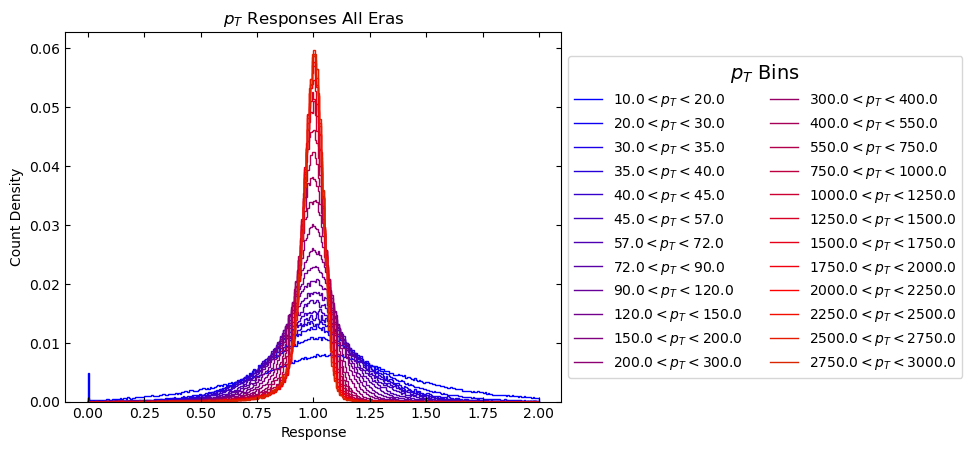

.project('pt', 'frac') numpy shape    ==>    (41, 300)



In [13]:
np_histogram_pt_frac, bin_edges = histograms.project("pt", "frac").to_numpy()[0], frac_bin_edges

color_map = plt.get_cmap('brg', len(pt_bin_centers))

min_pt_bin = 0
max_pt_bin = 24

for i in range(min_pt_bin, min(max_pt_bin, len(pt_bin_centers))):
    color = color_map(i / len(pt_bin_centers))
    normalized_y_vals = np_histogram_pt_frac[i] / np.sum(np_histogram_pt_frac[i])
    
    plt.stairs(normalized_y_vals, bin_edges, label=f"${pt_bin_edges[i]} <  p_{{T}}  < {pt_bin_edges[i + 1]}$", color=color)
    
plt.title("$p_T$ Responses All Eras")
plt.xlabel("Response")
plt.ylabel("Count Density")
legend = plt.legend(title=f"$p_T$ Bins", loc='center left', bbox_to_anchor=(1, 0.5), ncol=2)
legend.get_title().set_fontsize('14')
plt.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
plt.show()
    
print(f".project('pt', 'frac') numpy shape    ==>    {histograms.project('pt', 'frac').to_numpy()[0].shape}\n")

If we now define one last projection `.project('dataset', 'pt', 'frac')`, we can plot the $p_{T}$ response curves separately for each individual dataset:

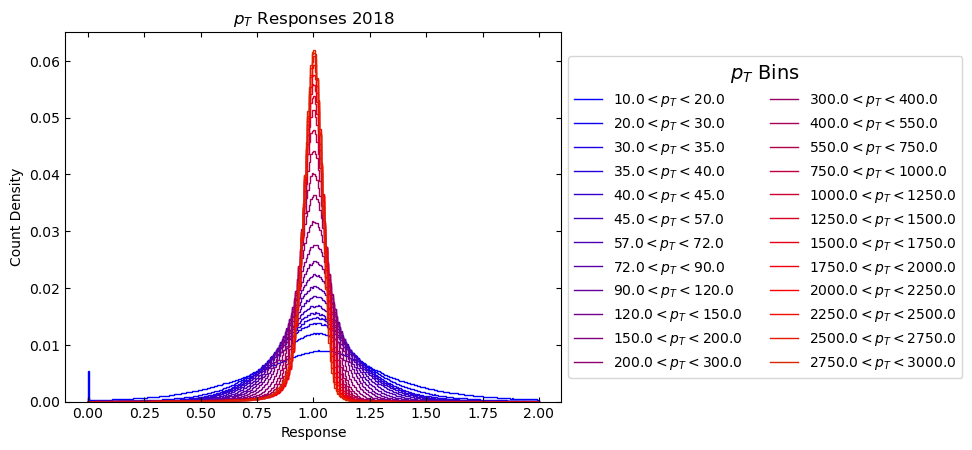

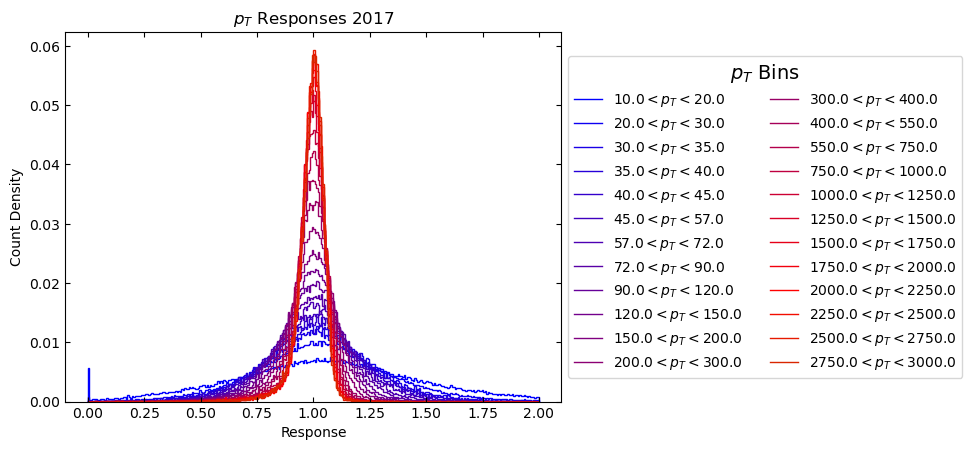

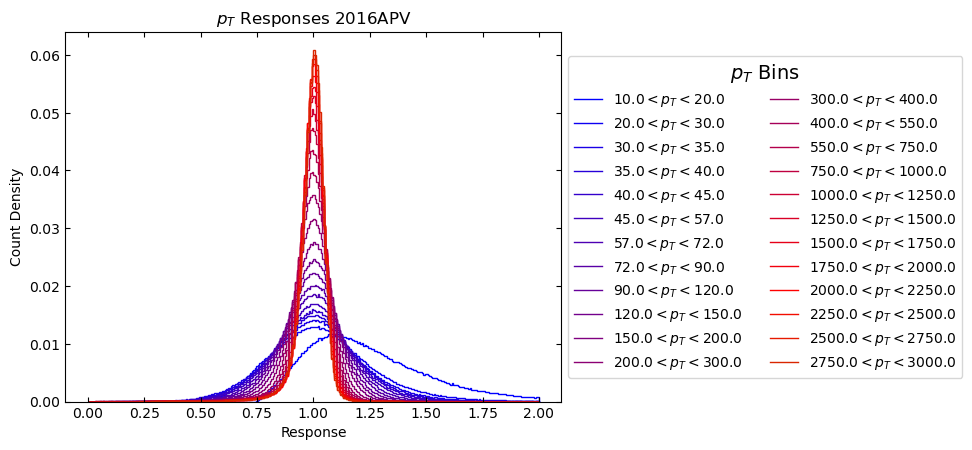

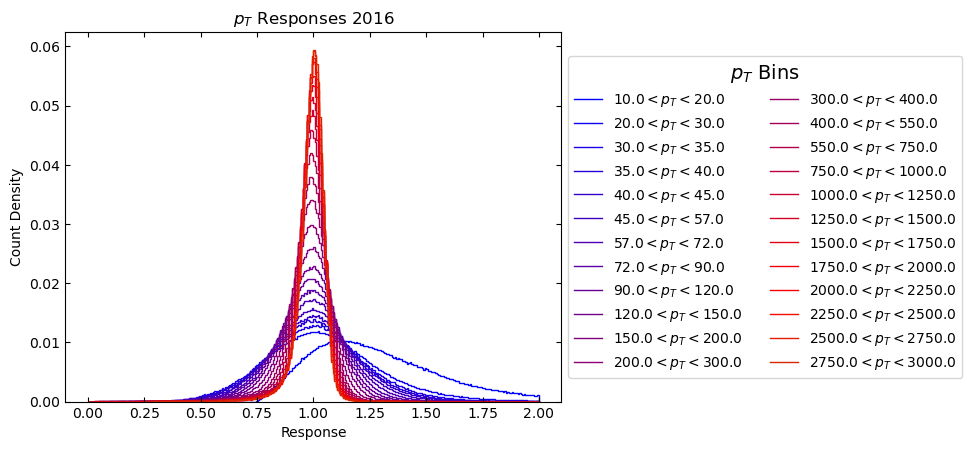

.project('dataset', 'pt', 'frac') numpy shape    ==>    (4, 41, 300)



In [14]:
np_histogram_dataset_pt_frac, bin_edges = histograms.project("dataset", "pt", "frac").to_numpy()[0], frac_bin_edges

color_map = plt.get_cmap('brg', len(pt_bin_centers))

min_pt_bin = 0
max_pt_bin = 24

for i, dataset in enumerate(np_histogram_dataset_pt_frac):
    for j, frac_vals in enumerate(dataset[min_pt_bin:max_pt_bin]):
        color = color_map(j, len(pt_bin_centers))
        normalized_y_vals = frac_vals / np.sum(frac_vals)
        
        plt.stairs(normalized_y_vals, bin_edges, label=f"${pt_bin_edges[min_pt_bin + j]} <  p_{{T}}  < {pt_bin_edges[min_pt_bin + j + 1]}$", color=color)
        
    plt.title(f"$p_T$ Responses {histograms.project('dataset', 'pt', 'frac').axes[0][i]}")
    plt.xlabel("Response")
    plt.ylabel("Count Density")
    legend = plt.legend(title=f"$p_T$ Bins", loc='center left', bbox_to_anchor=(1, 0.5), ncol=2)
    legend.get_title().set_fontsize('14')
    plt.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
    plt.show()
    
print(f".project('dataset', 'pt', 'frac') numpy shape    ==>    {histograms.project('dataset', 'pt', 'frac').to_numpy()[0].shape}\n")

Finally, we fit all response curves of each era to a gaussian function and display the results side-by-side:

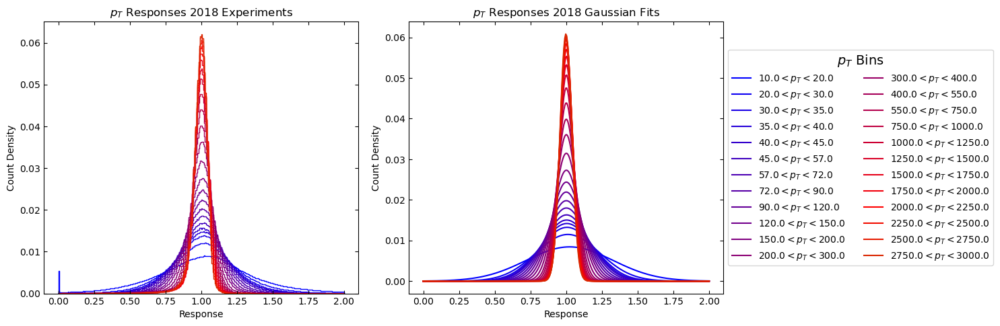

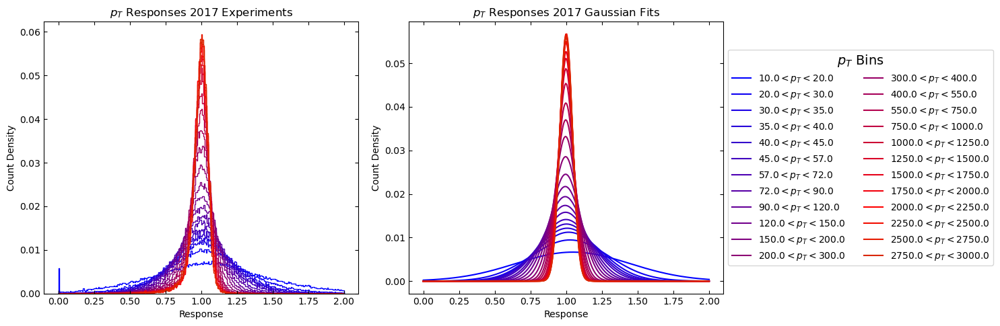

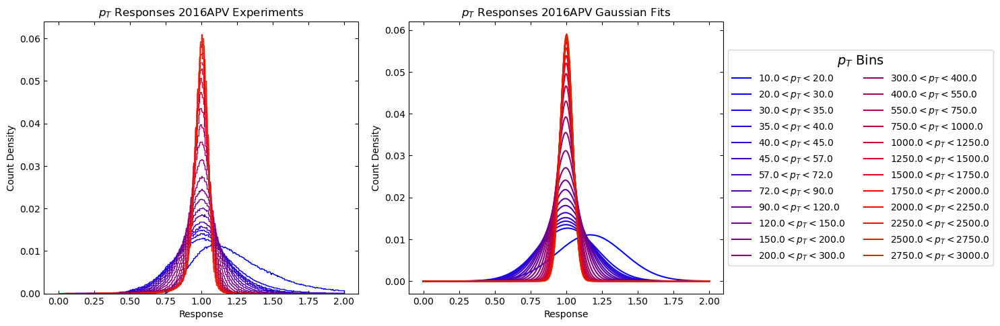

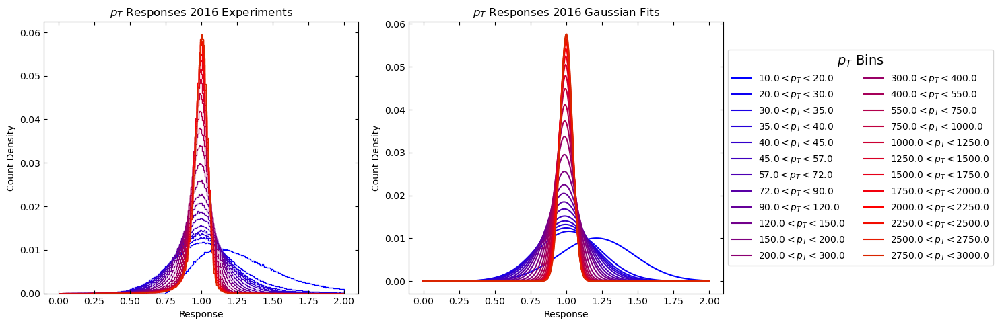

In [15]:
np_histogram_dataset_pt_frac, bin_edges = histograms.project("dataset", "pt", "frac").to_numpy()[0], frac_bin_edges
bin_centers = frac_bin_centers
frac_xspace = np.linspace(0, 2, 300)

color_map = plt.get_cmap('brg', len(pt_bin_centers))

min_pt_bin = 0
max_pt_bin = 24

#fit_parameters = {}

for i, dataset in enumerate(np_histogram_dataset_pt_frac):
    
    fig, axs = plt.subplots(1, 2, figsize=(15, 5))
    
#    era_parameters = []
    for j, frac_vals in enumerate(dataset[min_pt_bin:max_pt_bin]):
        color = color_map(j, len(pt_bin_centers))
        normalized_y_vals = frac_vals / np.sum(frac_vals)
        popt, pcov = curve_fit(gaussian_function, xdata=bin_centers, ydata=np.nan_to_num(normalized_y_vals), maxfev=1000000)
#        era_parameters.append((popt, pcov))
            
        axs[0].stairs(normalized_y_vals, bin_edges, label=f"${pt_bin_edges[min_pt_bin + j]} <  p_{{T}}  < {pt_bin_edges[min_pt_bin + j + 1]}$", color=color)
        axs[1].plot(frac_xspace, gaussian_function(frac_xspace, *popt), label=f"${pt_bin_edges[min_pt_bin + j]} <  p_{{T}}  < {pt_bin_edges[min_pt_bin + j + 1]}$", color=color)
        
#    fit_parameters[histograms.project('dataset', 'pt', 'frac').axes[0][i]] = era_parameters

    axs[0].set_title(f"$p_T$ Responses {histograms.project('dataset', 'pt', 'frac').axes[0][i]} Experiments")
    axs[0].set_xlabel("Response")
    axs[0].set_ylabel("Count Density")
    
    axs[1].set_title(f"$p_T$ Responses {histograms.project('dataset', 'pt', 'frac').axes[0][i]} Gaussian Fits")
    axs[1].set_xlabel("Response")
    axs[1].set_ylabel("Count Density")
    legend = axs[1].legend(title=f"$p_T$ Bins", loc='center left', bbox_to_anchor=(1, 0.5), ncol=2)
    legend.get_title().set_fontsize('14')
    
    plt.tight_layout()
    for ax in axs:
        ax.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
    plt.show()
    
#output_dir = "./gaussian_fit_files/"
#os.makedirs(output_dir, exist_ok=True)

#for key, value in fit_parameters.items():
#    filename = f"gaussian_parameters_pt_bins_{key}.csv"
#    filepath = os.path.join(output_dir, filename)
#    with open(filepath, mode='w', newline='') as file:
#        writer = csv.writer(file)
#        writer.writerow(['popt', 'pcov'])       
#        for popt, pcov in value:
#            writer.writerow([popt, pcov])

### Eta and Pile Up Binning

Our ultimate goal will be to obtain gaussian fits for histograms binned in $\eta$, $\rho$, and $p_{T}$ for each dataset. To this end, let us now define `.project("eta", "frac")` which will plot all $p_{T}$ for all eras in bins of pseudorapidity:

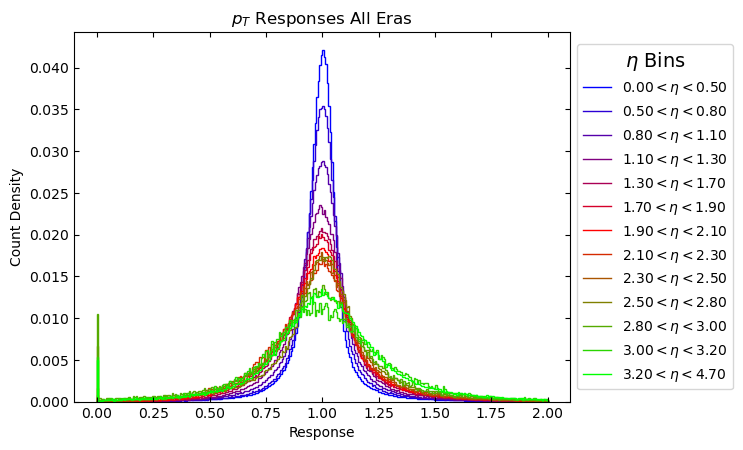

.project('eta', 'frac') numpy shape    ==>    (13, 300)



In [16]:
np_histogram_eta_frac, bin_edges = histograms.project("eta", "frac").to_numpy()[0], frac_bin_edges

color_map = plt.get_cmap('brg', len(np.abs(eta_bin_centers)))

min_eta_bin = 0
max_eta_bin = 13

for i in range(min_eta_bin, min(max_eta_bin, len(eta_bin_centers))):
    color = color_map(i / len(np.abs(eta_bin_centers)))
    normalized_y_vals = np_histogram_eta_frac[i] / np.sum(np_histogram_eta_frac[i])
    
    plt.stairs(normalized_y_vals, bin_edges, label=f"${eta_bin_edges[i]:.2f} <  \eta  < {eta_bin_edges[i + 1]:.2f}$", color=color)
    
plt.title("$p_T$ Responses All Eras")
plt.xlabel("Response")
plt.ylabel("Count Density")
legend = plt.legend(title=f"$\eta$ Bins", loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
legend.get_title().set_fontsize('14')
plt.tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
plt.show()
    
print(f".project('eta', 'frac') numpy shape    ==>    {histograms.project('eta', 'frac').to_numpy()[0].shape}\n")

Next we plot the $p_{T}$ response curves in bins of $\eta$ for each dataset using `.project("dataset", "eta", "pt", "frac")`. For convenience, we show the distributions in the barrel region of the detector ($\eta \le 1.3$) only:

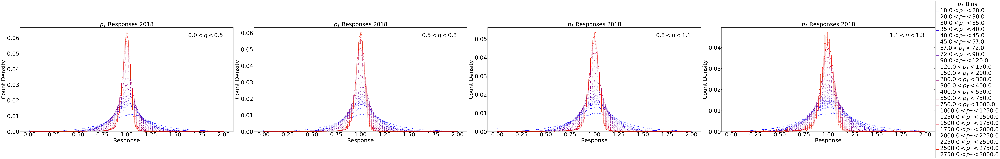

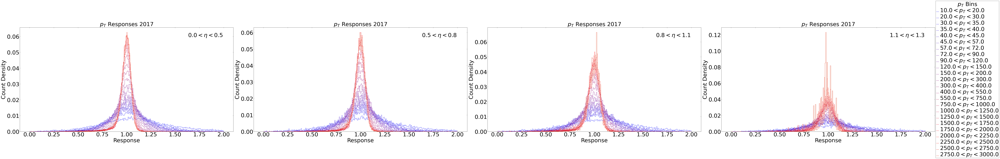

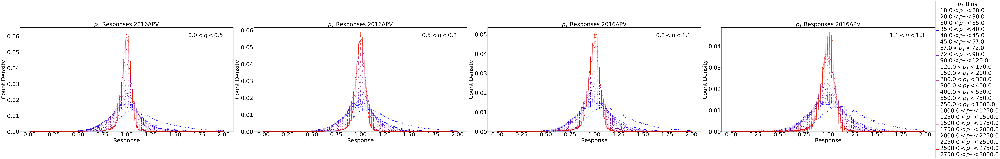

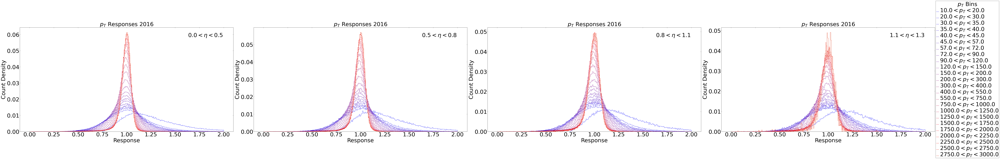

In [17]:
np_histogram_dataset_eta_pt_frac, bin_edges = histograms.project("dataset", "eta", "pt", "frac").to_numpy()[0], frac_bin_edges

color_map = plt.get_cmap('brg', len(pt_bin_centers))

min_pt_bin = 0
max_pt_bin = 24

min_eta_bin = 0
max_eta_bin = 4

fig_width = 25 * max_eta_bin

for i, dataset in enumerate(np_histogram_dataset_eta_pt_frac):
    
    fig, axs = plt.subplots(1, max_eta_bin, figsize=(fig_width, 15))
    
    for j, eta_vals in enumerate(dataset[min_eta_bin:max_eta_bin]):
        for k, frac_vals in enumerate(eta_vals[min_pt_bin:max_pt_bin]):
            color = color_map(k, len(pt_bin_centers))
            normalized_y_vals = frac_vals / np.sum(frac_vals)
            
            axs[j].stairs(normalized_y_vals, bin_edges, label=f"${pt_bin_edges[min_pt_bin + k]} <  p_{{T}}  < {pt_bin_edges[min_pt_bin + k + 1]}$", color=color)
            
        axs[j].set_title(f"$p_T$ Responses {histograms.project('dataset', 'eta', 'pt', 'frac').axes[0][i]}", fontsize=40)
        axs[j].set_xlabel("Response", fontsize=40)
        axs[j].set_ylabel("Count Density", fontsize=40)
        axs[j].text(0.95, 0.95, f"${eta_bin_edges[j]} < \eta < {eta_bin_edges[j + 1]}$", transform=axs[j].transAxes, ha='right', va='top', fontsize=40)
        axs[j].tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True, labelsize=40)
        if j == max_eta_bin - 1:
            legend = axs[j].legend(title=f"$p_T$ Bins", loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
            legend.get_title().set_fontsize(fontsize=40)
            legend.get_frame().set_linewidth(4)
            for label in legend.get_texts():
                label.set_fontsize(40)
                
    plt.tight_layout()
    plt.show()

To obtain plots of each $\eta$ in $\rho$ and $p_{T}$ bins, we define `.project("dataset", "eta", "rho", "pt", "frac")` to produce the desired plots:

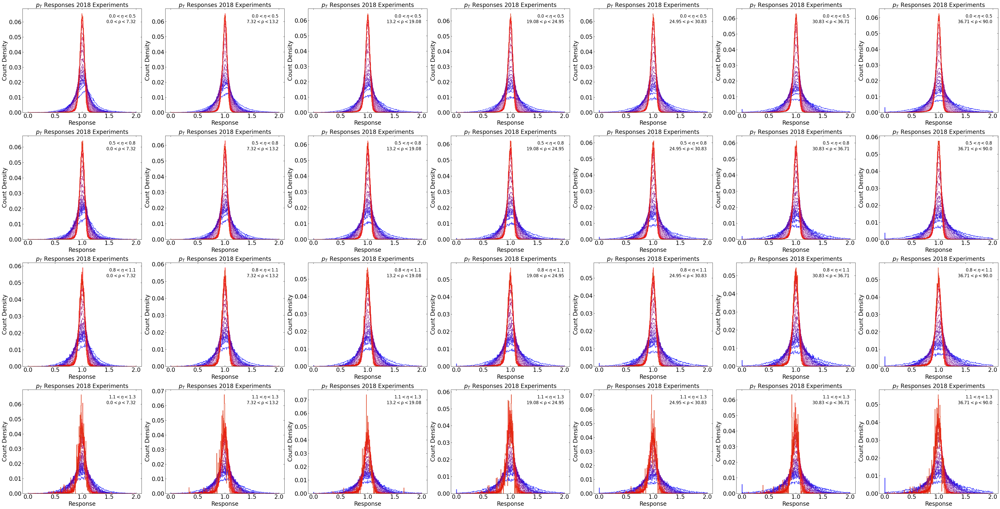

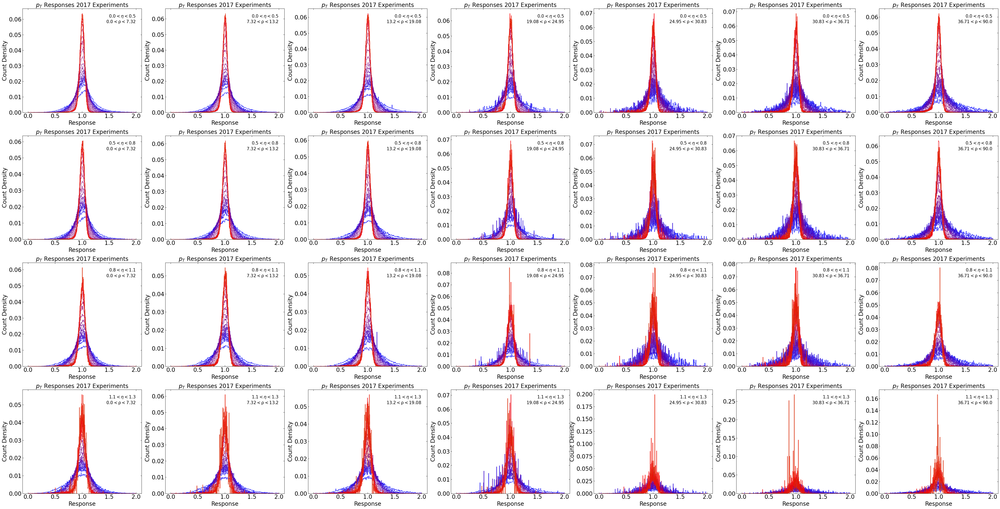

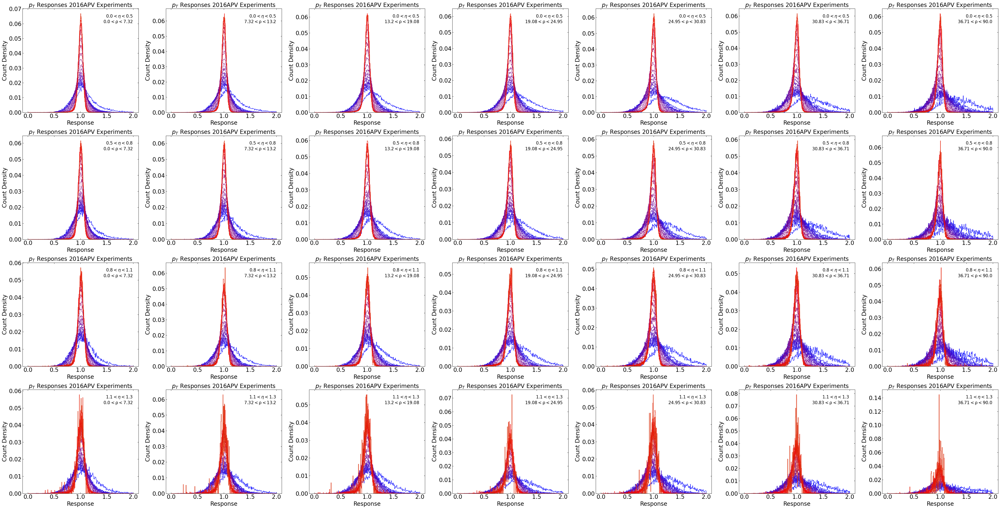

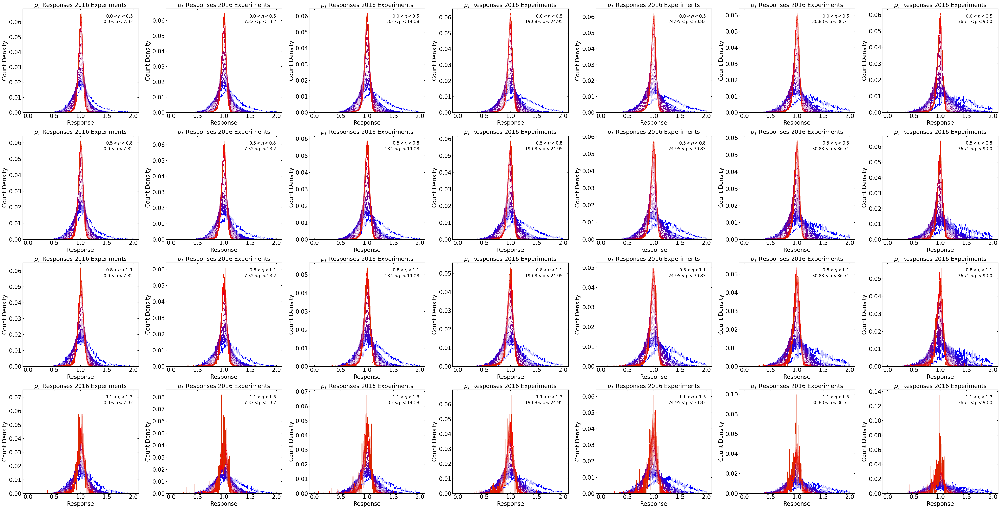

.project('dataset', 'eta', 'rho', 'pt', 'frac') numpy shape    ==>    (4, 13, 7, 41, 300)



In [18]:
np_histogram_dataset_eta_rho_pt_frac, bin_edges = histograms.project("dataset", "eta", "rho", "pt", "frac").to_numpy()[0], frac_bin_edges

color_map = plt.get_cmap('brg', len(pt_bin_centers))

min_pt_bin = 0
max_pt_bin = 24

min_eta_bin = 0
max_eta_bin = 4

min_rho_bin = 0
max_rho_bin = 7

fig_width = 7 * max_rho_bin

for i, dataset in enumerate(np_histogram_dataset_eta_rho_pt_frac):
    
    fig, axs = plt.subplots(max_eta_bin, max_rho_bin, figsize=(fig_width, 25))
    
    for j, eta_vals in enumerate(dataset[min_eta_bin:max_eta_bin]):
        for k, rho_vals in enumerate(eta_vals[min_rho_bin:max_rho_bin]):
            for l, frac_vals in enumerate(rho_vals[min_pt_bin:max_pt_bin]):
                color = color_map(l, len(pt_bin_centers))
                normalized_y_vals = frac_vals / np.sum(frac_vals)
                
                axs[j, k].stairs(normalized_y_vals, bin_edges, label=f"${pt_bin_edges[min_pt_bin + l]} <  p_{{T}}  < {pt_bin_edges[min_pt_bin + l + 1]}$", color=color)
                
    for j in range(max_eta_bin):
        for k in range(max_rho_bin):
            axs[j, k].set_title(f"$p_T$ Responses {histograms.project('dataset', 'eta', 'rho', 'pt', 'frac').axes[0][i]} Experiments", fontsize=20)
            axs[j, k].set_xlabel("Response", fontsize=20)
            axs[j, k].set_ylabel("Count Density", fontsize=20)
            axs[j, k].text(0.95, 0.95, f"${eta_bin_edges[j]} < \eta < {eta_bin_edges[j + 1]}$\n${rho_bin_edges[k]} < $\u03c1$ < {rho_bin_edges[k + 1]}$", transform=axs[j, k].transAxes, ha='right', va='top', fontsize=15)
            axs[j, k].tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True, labelsize=20)
            
    plt.tight_layout()
    plt.show()
    
print(f".project('dataset', 'eta', 'rho', 'pt', 'frac') numpy shape    ==>    {histograms.project('dataset', 'eta', 'rho', 'pt', 'frac').to_numpy()[0].shape}\n")

As before, we fit each of these plots to a gaussian function

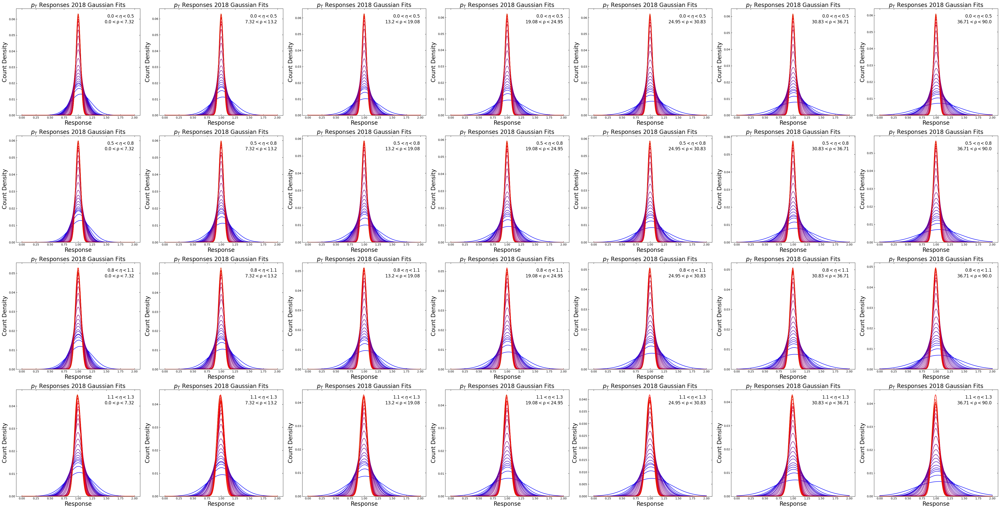

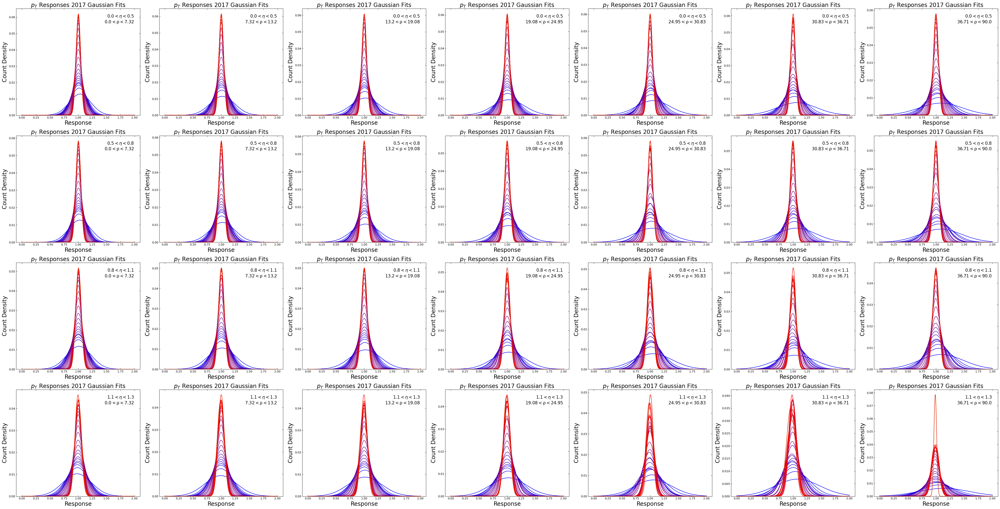

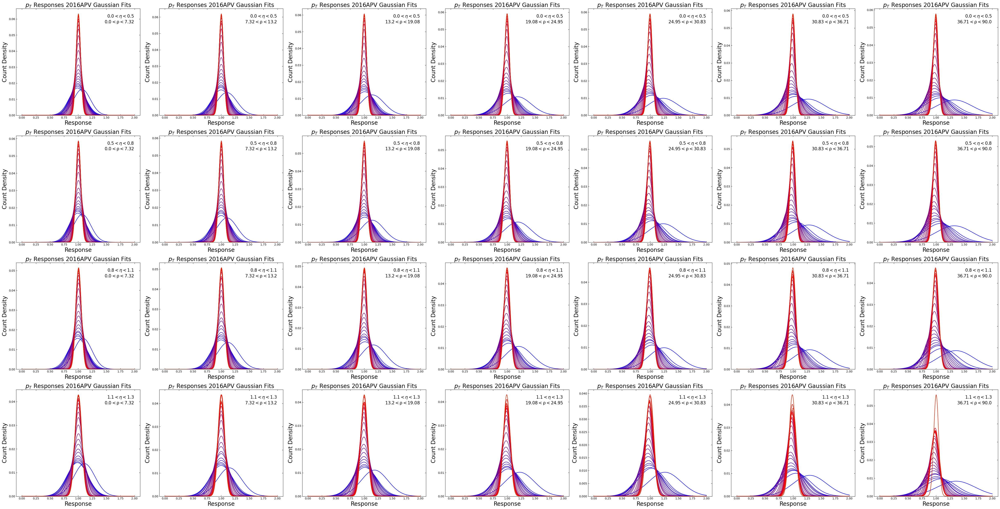

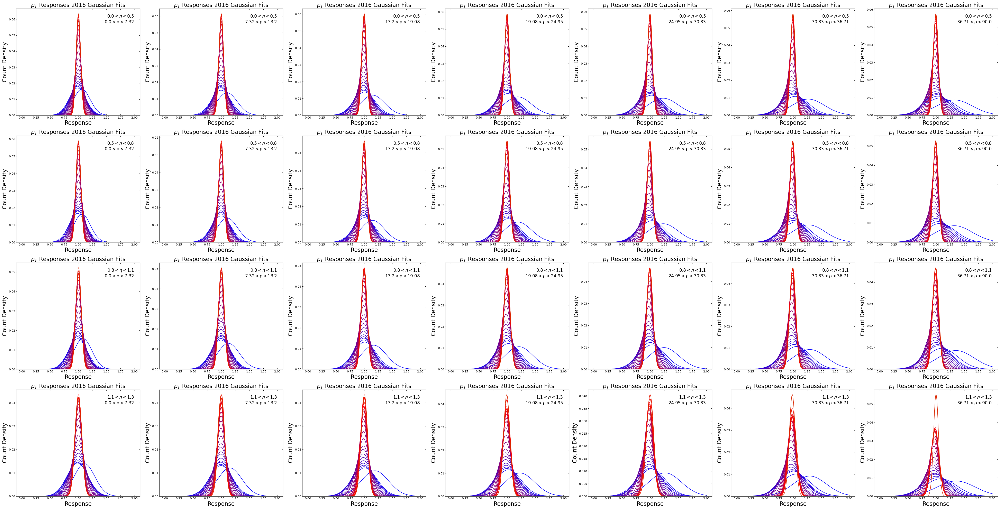

In [19]:
np_histogram_dataset_eta_rho_pt_frac, bin_edges = histograms.project("dataset", "eta", "rho", "pt", "frac").to_numpy()[0], frac_bin_edges
bin_centers = frac_bin_centers
frac_xspace = np.linspace(0, 2, 300)

color_map = plt.get_cmap('brg', len(pt_bin_centers))

min_pt_bin = 0
max_pt_bin = 24

min_eta_bin = 0
max_eta_bin = 4

min_rho_bin = 0
max_rho_bin = 7

fig_width = 7 * max_rho_bin

for i, dataset in enumerate(np_histogram_dataset_eta_rho_pt_frac):
    
    fig, axs = plt.subplots(max_eta_bin, max_rho_bin, figsize=(fig_width, 25))
    
    for j, eta_vals in enumerate(dataset[min_eta_bin:max_eta_bin]):
        
        for k, rho_vals in enumerate(eta_vals[min_rho_bin:max_rho_bin]):
            
            for l, frac_vals in enumerate(rho_vals[min_pt_bin:max_pt_bin]):
                color = color_map(l, len(pt_bin_centers))
                normalized_y_vals = frac_vals / np.sum(frac_vals)
                popt, pcov = curve_fit(gaussian_function, xdata=bin_centers, ydata=np.nan_to_num(normalized_y_vals), maxfev=1000000)
                
                axs[j, k].plot(frac_xspace, gaussian_function(frac_xspace, *popt), label=f"${pt_bin_edges[min_pt_bin + l]} <  p_{{T}}  < {pt_bin_edges[min_pt_bin + l + 1]}$", color=color)
                
    for j in range(max_eta_bin):
        for k in range(max_rho_bin):
            axs[j, k].set_title(f"$p_T$ Responses {histograms.project('dataset', 'eta', 'rho', 'pt', 'frac').axes[0][i]} Gaussian Fits", fontsize=20)
            axs[j, k].set_xlabel("Response", fontsize=20)
            axs[j, k].set_ylabel("Count Density", fontsize=20)
            axs[j, k].set_ylim(bottom=0)
            axs[j, k].text(0.95, 0.95, f"${eta_bin_edges[j]} < \eta < {eta_bin_edges[j + 1]}$\n${rho_bin_edges[k]} < $\u03c1$ < {rho_bin_edges[k + 1]}$", transform=axs[j, k].transAxes, ha='right', va='top', fontsize=15)
            axs[j, k].tick_params(axis='both', direction='in', which='both', bottom=True, top=True, left=True, right=True)
            
    plt.tight_layout()
    plt.show()

Lastly, we record the fitting parameters in `.csv` files for later analysis:

In [20]:
np_histogram_dataset_eta_rho_pt_frac, bin_edges = histograms.project("dataset", "eta", "rho", "pt", "frac").to_numpy()[0], frac_bin_edges
bin_centers = frac_bin_centers
frac_xspace = np.linspace(0, 2, 300)

min_pt_bin = 0
max_pt_bin = 24

fit_parameters = {}

for i, dataset in enumerate(np_histogram_dataset_eta_rho_pt_frac):
        
    era_parameters = {}
    
    for j, eta_vals in enumerate(dataset):
        
        eta_parameters = {}
        
        for k, rho_vals in enumerate(eta_vals):
            
            rho_parameters = []
            
            for l, frac_vals in enumerate(rho_vals[min_pt_bin:max_pt_bin]):
                normalized_y_vals = frac_vals / np.sum(frac_vals)
                popt, pcov = curve_fit(gaussian_function, xdata=bin_centers, ydata=np.nan_to_num(normalized_y_vals), maxfev=1000000000)
                
                rho_parameters.append((popt, pcov))
                
            eta_parameters[rho_bin_edges[k]] = rho_parameters
            
        era_parameters[eta_bin_edges[j]] = eta_parameters
    
    fit_parameters[histograms.project("dataset", "eta", "rho", "pt", "frac").axes[0][i]] = era_parameters

In [21]:
output_dir = "./gaussian_fit_files/"
os.makedirs(output_dir, exist_ok=True)

for era, era_parameters in fit_parameters.items():
    era_dir = os.path.join(output_dir, f"{era}")
    os.makedirs(era_dir, exist_ok=True)
    eta_list = list(era_parameters.keys())
    eta_pairs = [(eta_list[i], eta_list[i + 1]) if i < len(eta_list) - 1 else (eta_list[i], "4.7") for i in range(len(eta_list))]
    for eta_1, eta_2 in eta_pairs:
        eta_dir = os.path.join(era_dir, f"eta_{eta_1}-{eta_2}")
        os.makedirs(eta_dir, exist_ok=True)
        rho_list = list(era_parameters[eta_1].keys())
        rho_pairs = [(rho_1, rho_list[j + 1] if j + 1 < len(rho_list) else "90") for j, rho_1 in enumerate(rho_list)]
        for rho_1, rho_2 in rho_pairs:
            filename = f"gaussian_parameters_{era}_eta_{eta_1}-{eta_2}_rho_{rho_1}-{rho_2}.csv"
            filepath = os.path.join(eta_dir, filename)
            with open(filepath, mode='w', newline='') as file:
                writer = csv.writer(file)
                writer.writerow(['Bin', 'PT Center Bin Value', 'Amplitude', 'Mean', 'Standard Deviation', 'Var(Amplitude)', 'Var(Mean)', 'Var(Standard Deviation)'])
                for i, (pt, (popt, pcov)) in enumerate(zip(pt_bin_centers, era_parameters[eta_1][rho_1]), start=min_pt_bin):
                    amplitude, mean, stddev = popt
                    pt_val = pt
                    var_amplitude = pcov[0, 0] if pcov is not None else None
                    var_mean = pcov[1, 1] if pcov is not None else None
                    var_stddev = pcov[2, 2] if pcov is not None else None
                    writer.writerow([i, pt_val, amplitude, mean, stddev, var_amplitude, var_mean, var_stddev])